In [1]:
import gc

import torch
import utils
import enumeration
import utils_func
import torch
import gc

from torchvision.transforms import transforms
# set seed for the reproducibility of the results


gc.collect()
torch.cuda.empty_cache()


DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

MODEL_NAMES_DICT = {
    "SAT": "Engstrom2019Robustness",
}

/home/mary/miniconda3/envs/robustbench/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# parse arguments
import argparse

PARSER = argparse.ArgumentParser(description="Process some parameters.")
PARSER.add_argument("--wandb_logging", type=bool, default=False, help="log to wandb")
PARSER.add_argument("--batch_size", type=int, default=64, help="batch size")
PARSER.add_argument(
    "--dataset",
    type=str,
    default="cifar10",
    choices=["cifar10", "cifar100"],
    help="dataset",
)
PARSER.add_argument("--epsilon", type=float, default=8 / 255, help="epsilon")
PARSER.add_argument("--alpha", type=float, default=2 / 255, help="alpha")
PARSER.add_argument(
    "--sampling_iterations", type=int, default=20, help="sampling iterations"
)
PARSER.add_argument(
    "--architecture_name", type=str, default="WideResNet", help="architecture name"
)
PARSER.add_argument(
    "--from_robustbench", type=bool, default=True, help="load model from robustbench"
)
PARSER.add_argument(
    "--init",
    type=str,
    default="random",
    choices=["random", "pca", "gaussian", "informative", "informative+pca"],
    help="initialization for the generation",
)

PARSER.add_argument("--seed", type=int, default=0, help="random seed")
PARSER.add_argument("--data_dir", type=str, default="./data", help="data directory")
PARSER.add_argument(
    "--model_name",
    type=str,
    default="Zhang2019Theoretically",
    choices=[MODEL_NAMES_DICT.keys()],
    help="define the name of the model to be loaded",
)
PARSER.add_argument(
    "--model_source",
    type=str,
    default="robustbench",
    choices=["robustbench", "jem", "local"],
    help="the source from where the model is loaded",
)
PARSER.add_argument(
    "--model_dir",
    type=str,
    default="./models",
)
PARSER.add_argument(
    "--threat model",
    type=str,
    default="L2",
    choices=["Linf", "L2"],
    help="threat model",
)


try:
    args = PARSER.parse_args()
    wandb = args.wandb_logging
    batch_size = args.batch_size
    dataset = args.dataset
    epsilon = args.epsilon
    alpha = args.alpha
    sampling_iterations = args.sampling_iterations
    architecture_name = args.architecture_name
    from_robustbench = args.from_robustbench
    seed = args.seed
    model_name = args.model_name
    model_source = args.model_source
    data_dir = args.data_dir    
    threat_model = args.threat_model

    print("Using arguments from parser")

except:
    print("Using default arguments")
    wandb = False
    batch_size = 64
    dataset = "cifar10"
    epsilon = 8 / 255
    alpha = 2 / 255
    sampling_iterations = 20
    architecture_name = "WideResNet"
    from_robustbench = True
    init = "random"
    data_dir = "./data"
    seed = 0
    model_name = "Wang2020Improving"
    source = 'robustbench'
    model_dir = "./models"
    threat_model = "Linf"

from utils import fix_seed

fix_seed(seed=seed)


# logging on wandb
if wandb:
    import wandb

    config = {
        "dataset": dataset,
        "batch_size": batch_size,
        "epsilon": epsilon,
        "alpha": alpha,
        "sampling_iterations": sampling_iterations,
        "architecture name": architecture_name,
        "from_robustbench": from_robustbench,
        "initialization": init,
        "model name": model_name,
        "model source": model_source,
    }
    wandb.init(name="generation", project="LE-PGD", entity="le-pgd", config=config)

Using default arguments


In [3]:
TRANSFORM = transforms.Compose(
    [
        transforms.ToTensor(),
    ]
)

DATASET_TRAIN, DATASET_TEST = utils.load_clean_dataset(
    dataset=enumeration.BenchmarkDataset(dataset.lower()),
    n_examples=None,
    data_dir=data_dir,
    transform=TRANSFORM,
)

BATCH_SIZE = 1000

TRAIN_DATALOADER = torch.utils.data.DataLoader(
    DATASET_TRAIN, batch_size=BATCH_SIZE, shuffle=True
)

TEST_DATALOADER = torch.utils.data.DataLoader(
    DATASET_TEST, batch_size=BATCH_SIZE, shuffle=False
)
print(f"threat model: {threat_model}")

Files already downloaded and verified
Files already downloaded and verified
threat model: Linf


## Load the model

In [4]:

from JEMPP.models.wideresnet import Wide_ResNet as WideResNet

ARCHITECTURE_DICT = {"wideresnet": WideResNet}

assert architecture_name.lower() in ARCHITECTURE_DICT.keys()

In [5]:
from robustbench.utils import load_model
from torch import nn
from JEMPP.models.jem_models import F, CCF

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
MODELS = {m_name: None for m_name in MODEL_NAMES_DICT.keys()}

for model_name_i, MODEL_NAMES_DICT_model_name_i in MODEL_NAMES_DICT.items():

    if model_source == "robustbench":
        model = load_model(
            model_name=MODEL_NAMES_DICT_model_name_i,
            dataset=dataset,
            threat_model=threat_model,
            model_dir="./models",
        )
        model = nn.DataParallel(model, device_ids=[0])
        model.to(device)
    elif model_source == "jem":
        model_cls = F
        model = model_cls(
            enumeration.dataset_image_size[dataset],
            enumeration.dataset_num_classes[dataset],
            norm="batch",
            n_classes=enumeration.dataset_num_classes[dataset],
            model="wrn",
        )
        ckpt_dict = torch.load("./models/cifar10/Linf/sadajem5_95.5_9.4.pt")
        model.load_state_dict(ckpt_dict["model_state_dict"])
        model = nn.DataParallel(model, device_ids=[0, 1])
        model.to(device)

    elif model_source == "local":
        model_path = model_dir + "/wandb_model/" + model_name + ".pt"
        # check missimg 2 factors in architecture instanciation
        model = (
            ARCHITECTURE_DICT[architecture_name]()
            .to(device)
            .load_state_dict(torch.load(model_path))
            .eval()
        )

    MODELS[model_name_i] = model.module
    del model
    print(f"Model {model_name_i} loaded")

Model SAT loaded


In [6]:
utils_func.category_mean(
    dload_train=TRAIN_DATALOADER,
    n_classes=enumeration.dataset_num_classes[dataset],
    name_dataset=dataset,
    image_size=enumeration.dataset_image_size[dataset],
    n_channels=3,
    data_dir=data_dir,
)
BUFFER = utils.center_initialization(
    dataset=dataset, n_classes=enumeration.dataset_num_classes[dataset]
)

REPLAY_BUFFER = []

> Mean and Covariance Already Computed, skipping


## plot the energy of the real sample

In [7]:
BATCH = next(iter(TRAIN_DATALOADER))
# images
BATCH_IMAGES = BATCH[0].to(device)
# labels
BATCH_LABELS = BATCH[1].to(device)

 first 10 images of the batch of images


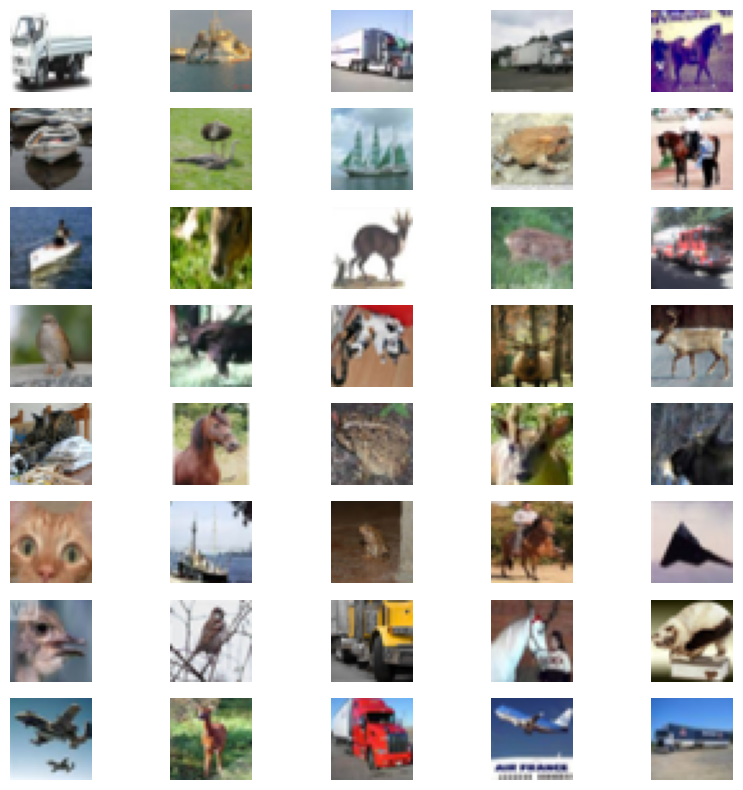

In [8]:
# plot the first 10 images of teh batch of images
import matplotlib.pyplot as plt

print(" first 10 images of the batch of images")
plt.figure(figsize=(10, 10))
for i in range(40):
    plt.subplot(8, 5, i + 1)
    plt.imshow(BATCH_IMAGES[i].cpu().permute(1, 2, 0))
    plt.axis("off")
plt.show()

## The histogram plots the average of the energies for each class

/media/mary/T7/code/LE_PGD/ablation
loading mean and stddev energy


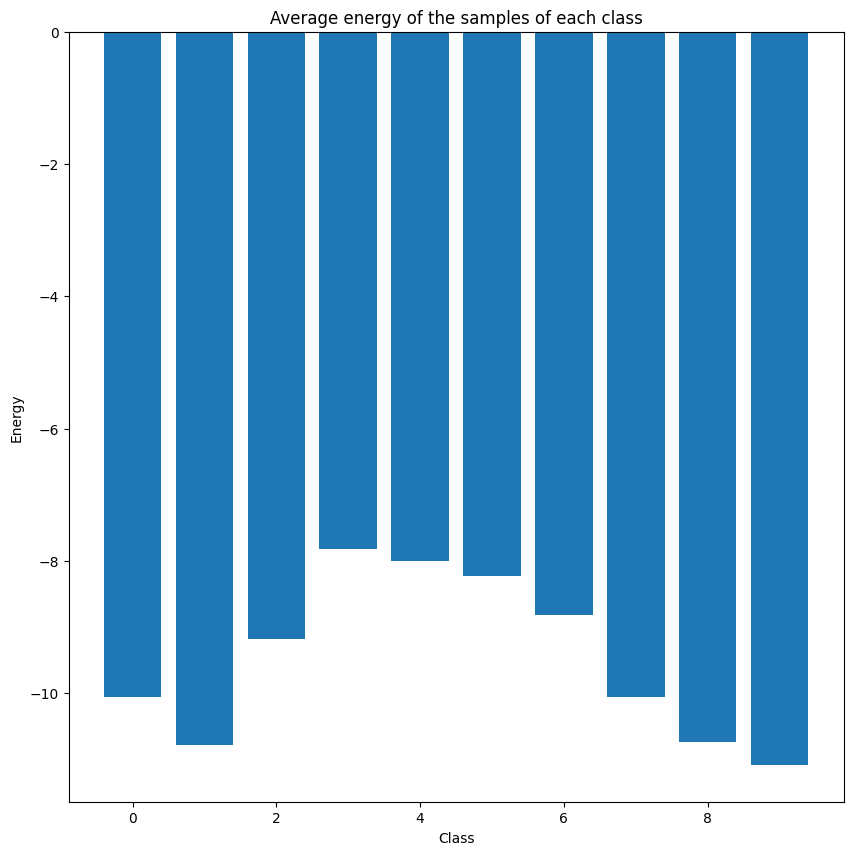

In [9]:
# obtain the energy of a sample of a certain class
import matplotlib.pyplot as plt
import numpy as np
import utils_func

import pickle, os
cur_dir  = os.getcwd()
print(cur_dir)
if not os.path.exists(cur_dir + f"/data/mean_en_cifar10.pkl") and not os.path.exists(cur_dir + f"/data/mean_en_{dataset}.pkl"):
    # plot the average of the energy of the samples of each class
    print("average energy of the samples of each class")
    EN_FOR_CLASS = {i: [] for i in range(10)}
    STDDEV_EN_PER_CLASS = {i: [] for i in range(10)}

    for i, image in enumerate(BATCH_IMAGES):
        logits = MODELS["SAT"](image)
        en = utils_func.compute_energy_xy(logits, BATCH_LABELS[i])
        EN_FOR_CLASS[BATCH_LABELS[i].item()].append(en.item())
        # compute stddv of the energy of the samples of each class
        STDDEV_EN_PER_CLASS[BATCH_LABELS[i].item()].append(en.item())    
    

    MEAN_EN = []
    STDDEV_EN = []
    # average energy of the samples of each class
    for i in range(10):
        print(f"class {i} : {np.mean(EN_FOR_CLASS[i])}")
        MEAN_EN.append(np.mean(EN_FOR_CLASS[i]))
        
    # compute the stddev for each class
    for i in range(10):
        print(f"class {i} : {np.std(STDDEV_EN_PER_CLASS[i])}")
        STDDEV_EN.append(np.std(STDDEV_EN_PER_CLASS[i]))
        
    with open(cur_dir + f"/data/mean_en_cifar10.pkl", "wb") as f:
        pickle.dump(MEAN_EN, f)
    with open(cur_dir + f"/data/mean_en_{dataset}.pkl", "wb") as f:
        pickle.dump(STDDEV_EN, f)
    
else:
    print("loading mean and stddev energy")
    with open(cur_dir + f"/data/mean_en_cifar10.pkl", "rb") as f:
        MEAN_EN = pickle.load(f)
    with open(cur_dir + f"/data/mean_en_{dataset}.pkl", "rb") as f:
        STDDEV_EN = pickle.load(f)

# plot the average of the energy of the samples of each class as histograms
plt.figure(figsize=(10, 10))
plt.bar(range(10), MEAN_EN)
plt.xlabel("Class")
plt.ylabel("Energy")
plt.title("Average energy of the samples of each class")
plt.show()


# plot the energy of the generation of a single image 

In [10]:
NUM_SAMPLES = 5
LABEL_TO_PLOT = list(range(10))
LABEL_TO_PLOT = [LABEL_TO_PLOT[:len(LABEL_TO_PLOT) // 2], LABEL_TO_PLOT[len(LABEL_TO_PLOT) // 2:]]
print(LABEL_TO_PLOT)
N_STEPS = 50
num_classes = 10

[[0, 1, 2, 3, 4], [5, 6, 7, 8, 9]]


# the loss function to be considered is `energy_xy `
In this case we ablate over two parameters :
- Momentum;
- Metropolis Hastings algorithm for accepting/rejecting the changes of the Brownian motion;

The last parameter is a sort of early stopping, but based on the energies. Since the energy is not constrained by any loss, we will always considered this parameter not varying.

## the plot is  with simple loss = `energy_xy`
No Metropolis hastings algorithm 


No early stopping


No Momentum


In [11]:
info_ENERGY_DICT_xy = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_ENERGY_DICT_xy = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


/home/mary/miniconda3/envs/robustbench/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1695392020201/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


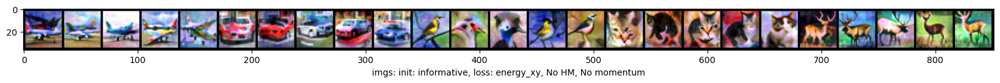

SAT


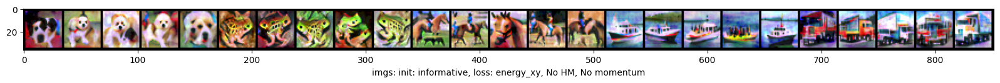

PLOT of THE PCA INIT
SAT


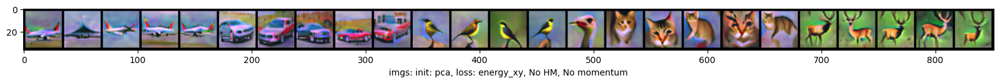

SAT


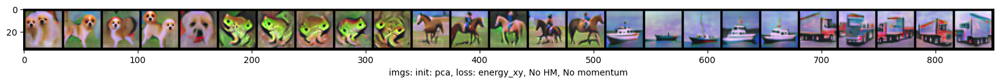

PLOT of  THE REAL IMAGES


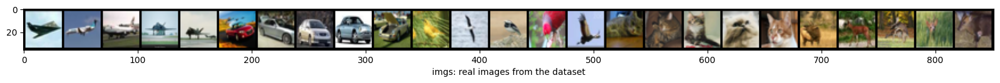

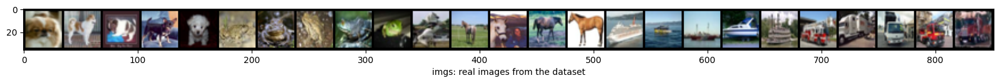

In [12]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_ENERGY_DICT_xy[key] = value

info_ENERGY_DICT={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_ENERGY_DICT_xy.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        info_ENERGY_DICT[key].append(flag_list)

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_ENERGY_DICT_xy[key] = value


pca_ENERGY_DICT={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_ENERGY_DICT_xy.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        pca_ENERGY_DICT[key].append(flag_list)


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

The energy plot of the informative generation

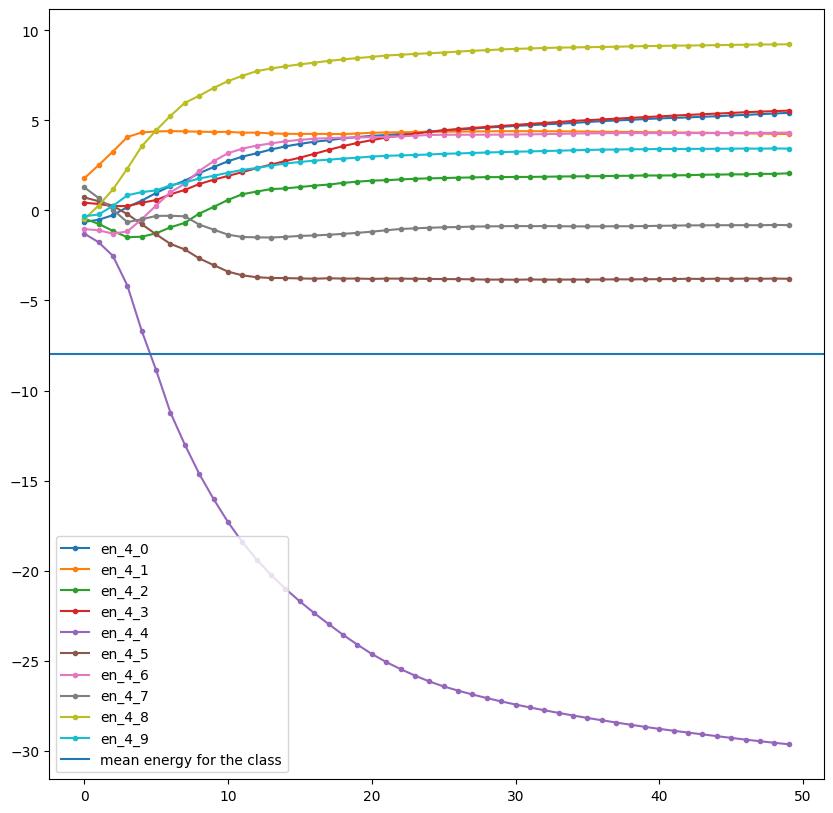

In [13]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 4

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_ENERGY_DICT[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


The energy plot of the generation with pca


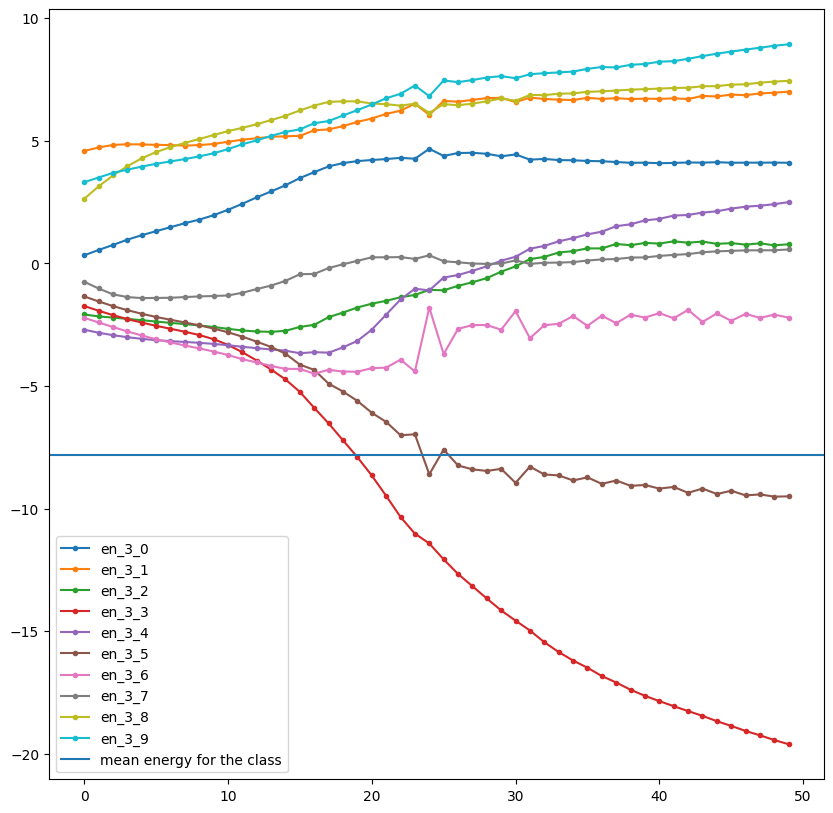

In [14]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 3

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(10):
    plt.plot(pca_ENERGY_DICT[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()

## the plot with simple loss = `energy_xy`
No Metropolis hastings algorithm 


No early stopping


With Momentum 


In [15]:
info_ENERGY_DICT_xy_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_ENERGY_DICT_xy_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


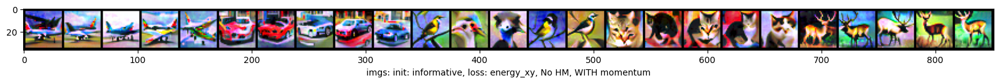

SAT


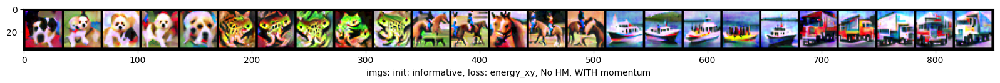

PLOT of THE PCA INIT
SAT


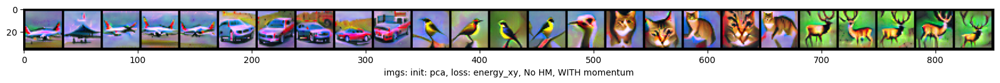

SAT


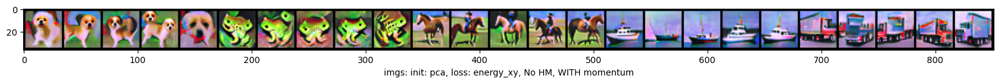

PLOT of  THE REAL IMAGES


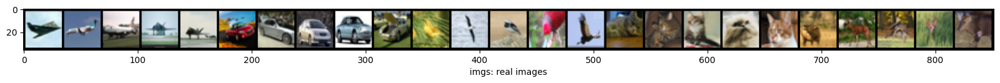

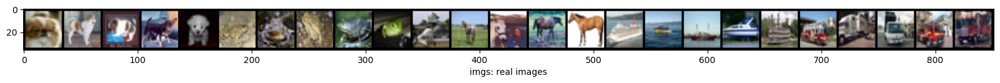

In [16]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            momentum = 0.5
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: energy_xy, No HM, WITH momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_ENERGY_DICT_xy_momentum[key] = value


info_ENERGY_DICT_momentum={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_ENERGY_DICT_xy_momentum.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        info_ENERGY_DICT_momentum[key].append(flag_list)

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum = 0.5
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: energy_xy, No HM, WITH momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_ENERGY_DICT_xy_momentum[key] = value


pca_ENERGY_DICT_momentum={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_ENERGY_DICT_xy_momentum.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        pca_ENERGY_DICT_momentum[key].append(flag_list)


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

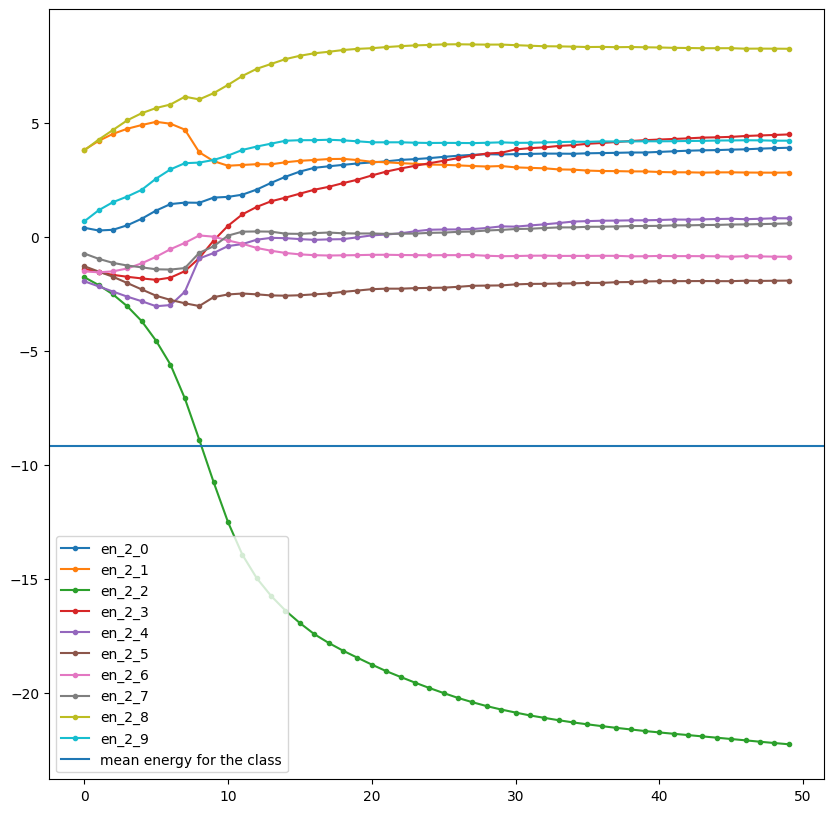

In [17]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 2

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_ENERGY_DICT_momentum[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


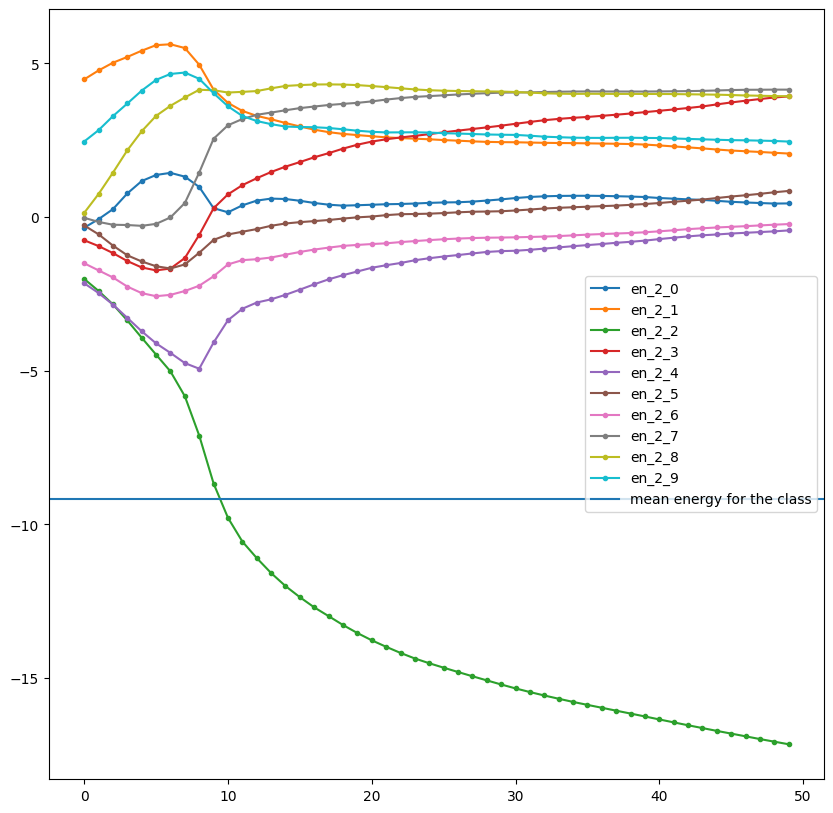

In [18]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 2

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_ENERGY_DICT_momentum[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


## the plot with simple loss = `energy_xy`
With Metropolis hastings algorithm 


No early stopping


No Momentum 


In [19]:
info_ENERGY_DICT_xy_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_ENERGY_DICT_xy_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


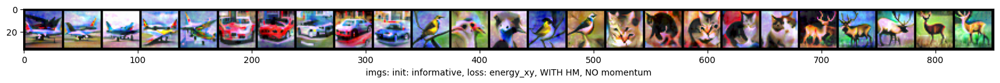

SAT


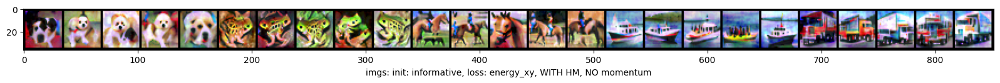

PLOT of THE PCA INIT
SAT


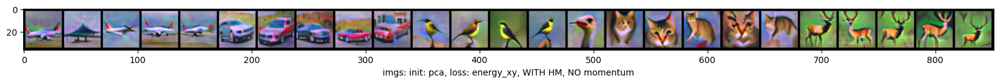

SAT


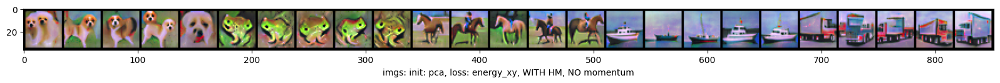

PLOT of  THE REAL IMAGES


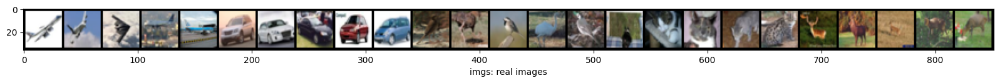

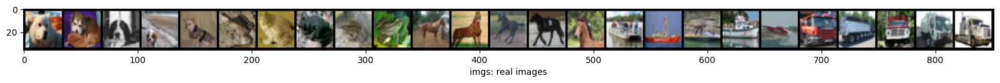

In [20]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: energy_xy, WITH HM, NO momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_ENERGY_DICT_xy_MH[key] = value


info_ENERGY_DICT_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_ENERGY_DICT_xy_MH.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        info_ENERGY_DICT_MH[key].append(flag_list)

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: energy_xy, WITH HM, NO momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_ENERGY_DICT_xy_MH[key] = value


pca_ENERGY_DICT_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_ENERGY_DICT_xy_MH.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        pca_ENERGY_DICT_MH[key].append(flag_list)


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

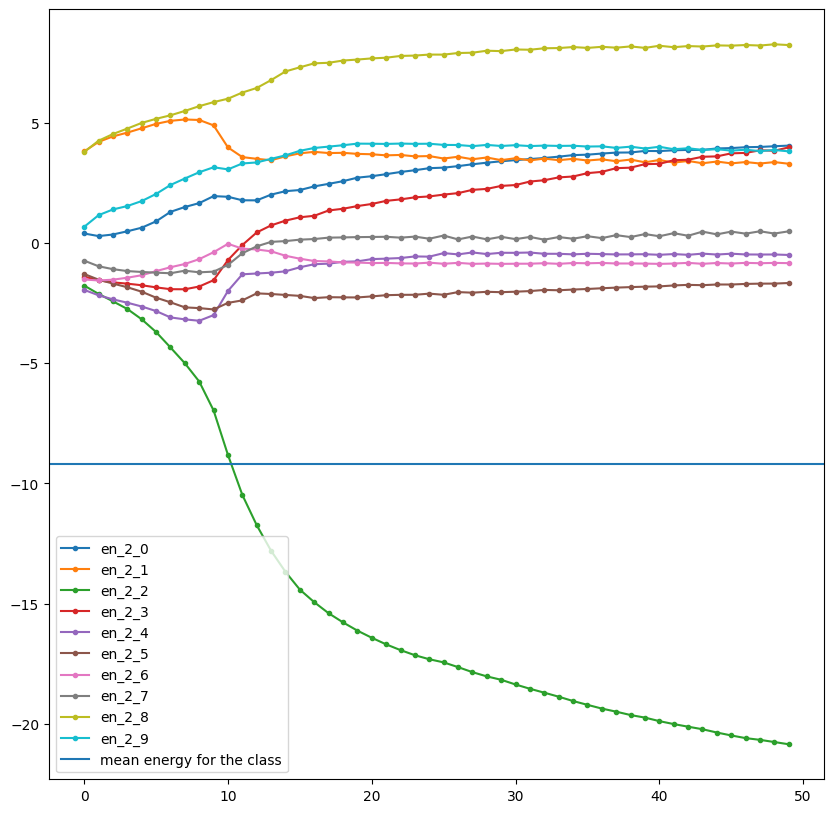

In [21]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 2

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_ENERGY_DICT_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


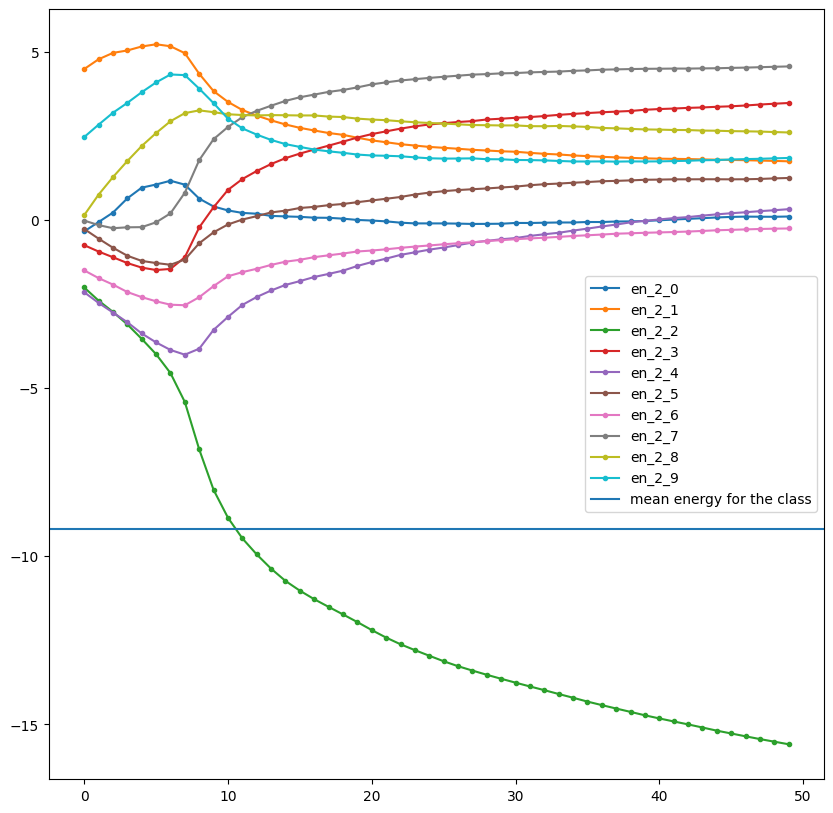

In [22]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 2

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_ENERGY_DICT_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


## the plot with simple loss = `energy_xy`
With Metropolis hastings algorithm 

No early stoppiing

With Momentum 


In [23]:
info_ENERGY_DICT_xy_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_ENERGY_DICT_xy_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


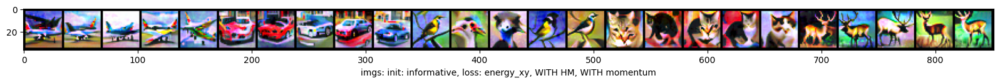

SAT


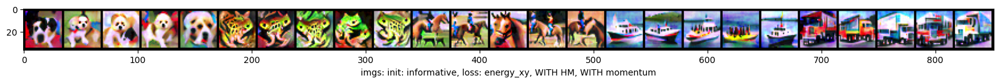

PLOT of THE PCA INIT
SAT


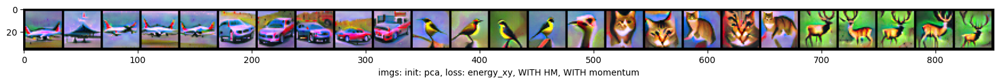

SAT


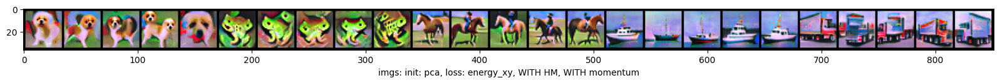

PLOT of  THE REAL IMAGES


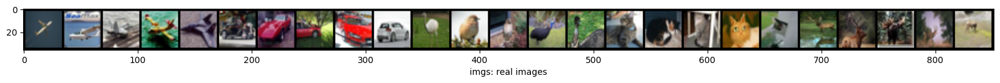

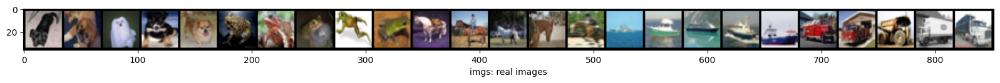

In [24]:
print("PLOT of THE INFORMATIVE INIT")
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: energy_xy, WITH HM, WITH momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_ENERGY_DICT_xy_momentum_MH[key] = value


info_ENERGY_DICT_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_ENERGY_DICT_xy_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        flag_list =[]
        for i in range(0, len(value), NUM_SAMPLES):
            
            try:
                flag_list.append(value[i + sample])
            except:
                pass 

        info_ENERGY_DICT_momentum_MH[key].append(flag_list)

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: energy_xy, WITH HM, WITH momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_ENERGY_DICT_xy_momentum_MH[key] = value

pca_ENERGY_DICT_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_ENERGY_DICT_xy_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        flag_list =[]
        for i in range(0, len(value), NUM_SAMPLES):
            
            try:
                flag_list.append(value[i + sample])
            except:
                pass 

        pca_ENERGY_DICT_momentum_MH[key].append(flag_list)

## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
   )

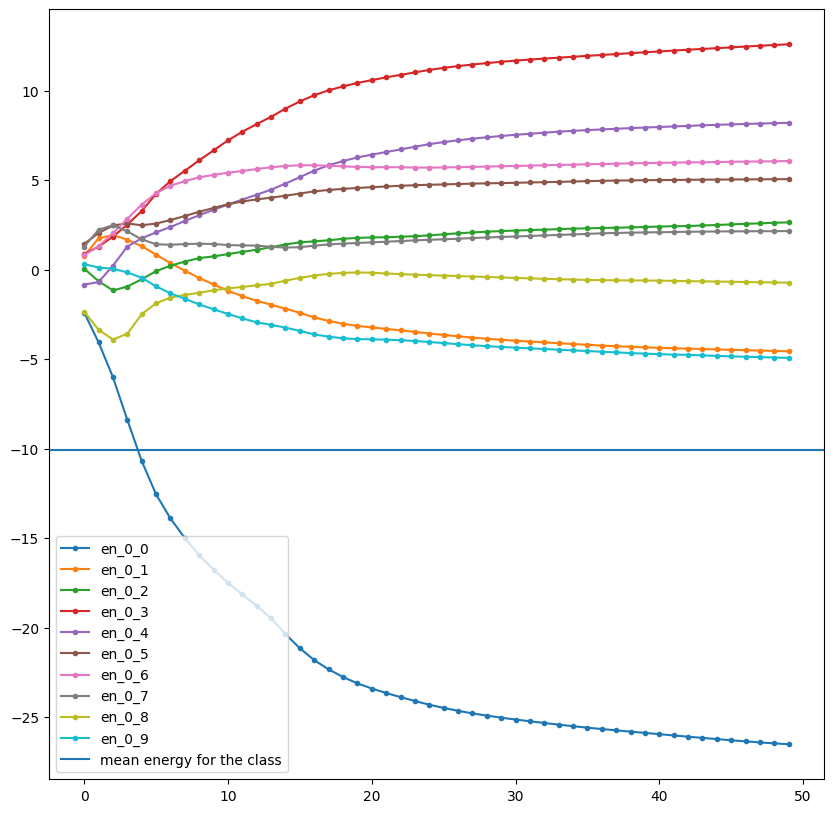

In [25]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 3
class_index = 0

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_ENERGY_DICT_momentum_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


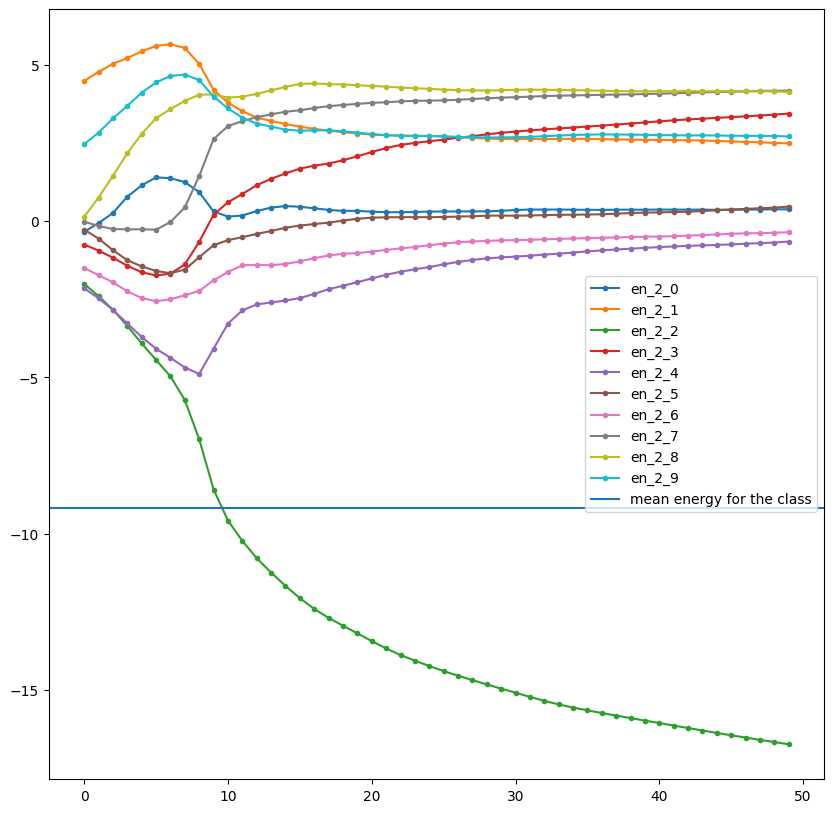

In [26]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt

sample_index = 1
class_index = 2

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes
for c in range(num_classes):
    plt.plot(
        pca_ENERGY_DICT_momentum_MH[f"{class_index}_{c}"][sample_index],
        ".-",
        label=f"en_{class_index}_{c}",
    )

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index], linestyle="-", label="mean energy for the class")
plt.legend()
plt.show()

# the loss function to be considered is `reference_energy_xy `
In this case we ablate over two parameters :
- Momentum;
- Metropolis Hastings algorithm for accepting/rejecting the changes of the Brownian motion;

The last parameter is an early stopping based on the energy. The parameter will be ablated keeping it fixed once as enabled and once as disabled so that the difference can be seen 

## the plot is  with  loss = `reference_energy_xy` and NO early stopping 
No Metropolis hastings algorithm 


No Momentum


In [27]:
info_REFERENCE_ENERGY_DICT_xy = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


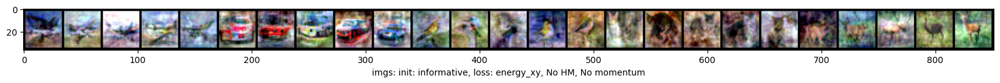

SAT


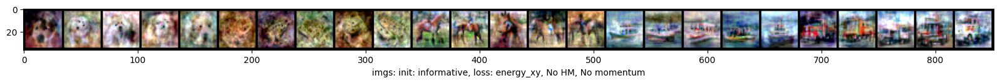

PLOT of THE PCA INIT
SAT


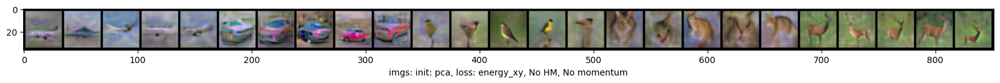

SAT


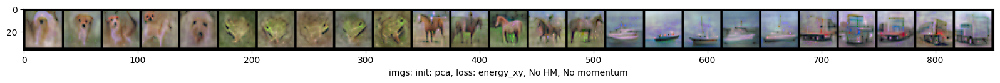

PLOT of  THE REAL IMAGES


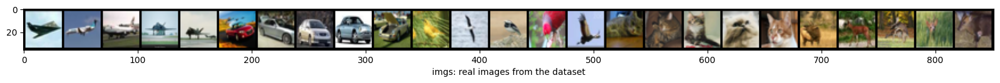

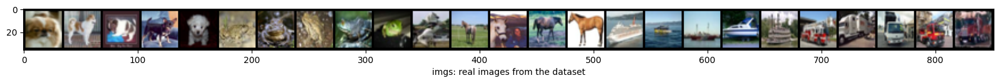

In [28]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy[key] = value

info_REFERENCE_ENERGY_DICT={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        info_REFERENCE_ENERGY_DICT[key].append(flag_list)

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy[key] = value


pca_REFERENCE_ENERGY_DICT={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy.items():
    for sample in range(NUM_SAMPLES):
        flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
        pca_REFERENCE_ENERGY_DICT[key].append(flag_list)


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

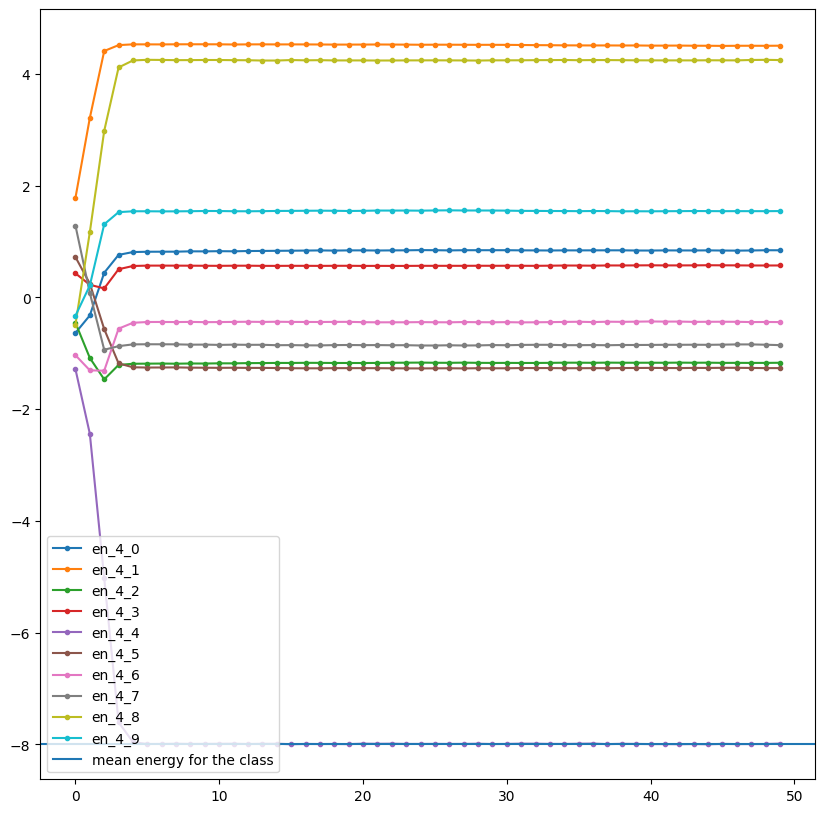

In [29]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 1
class_index = 4

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


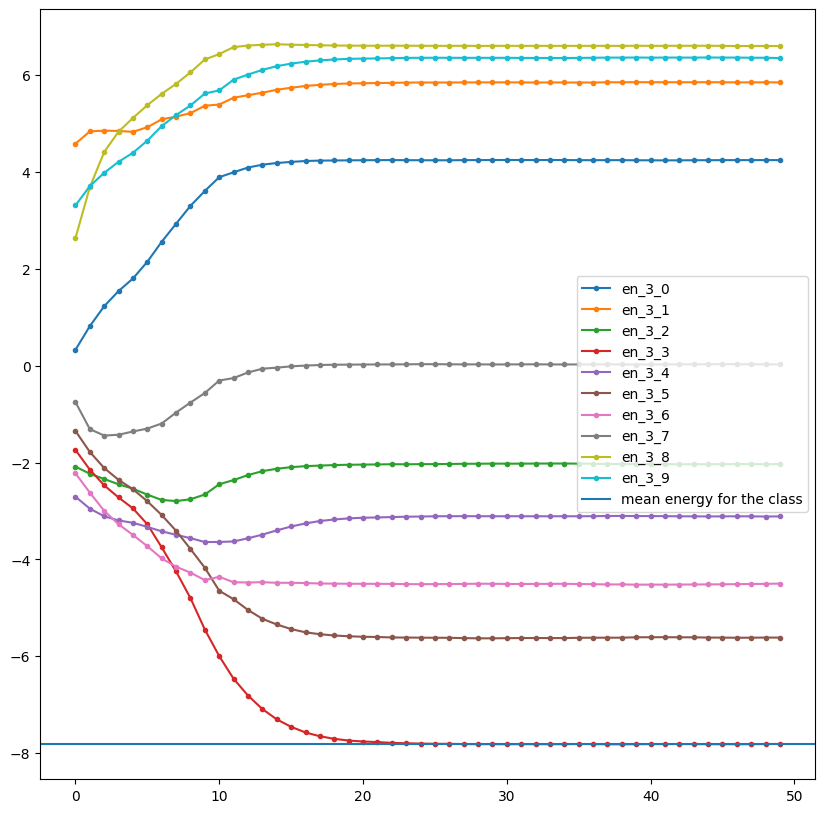

In [30]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 3

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(10):
    plt.plot(pca_REFERENCE_ENERGY_DICT[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()

## the plot is  with  loss = `reference_energy_xy` and WITH early stopping 
No Metropolis hastings algorithm 


No Momentum


In [31]:
info_REFERENCE_ENERGY_DICT_xy_adaptive = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_adaptive = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


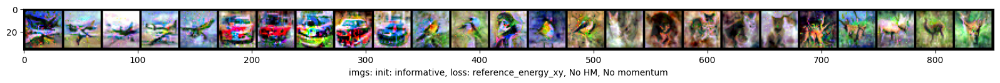

SAT


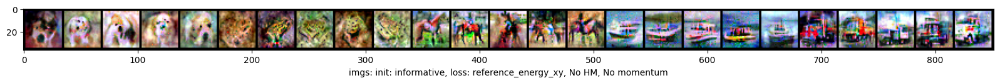

PLOT of THE PCA INIT
SAT


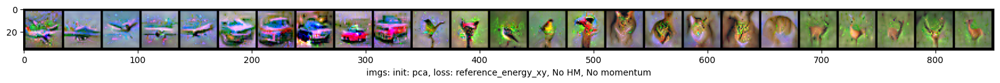

SAT


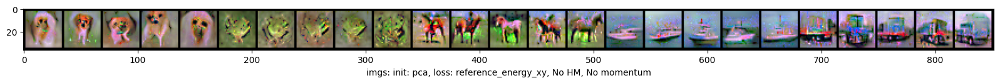

PLOT of  THE REAL IMAGES


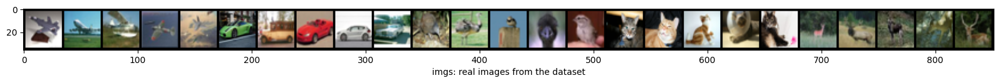

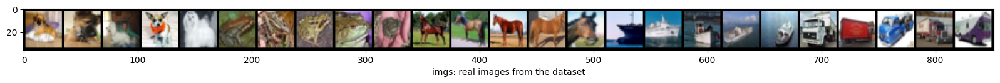

In [32]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            adaptive = 0.001
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_adaptive[key] = value

info_REFERENCE_ENERGY_DICT_adaptive={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_adaptive.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_adaptive[key].append(flag_list)
        except:
            pass
        
print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            adaptive = 0.001
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_adaptive[key] = value


pca_REFERENCE_ENERGY_DICT_adaptive={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_adaptive.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_adaptive[key].append(flag_list)
        except:
            pass
        

## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

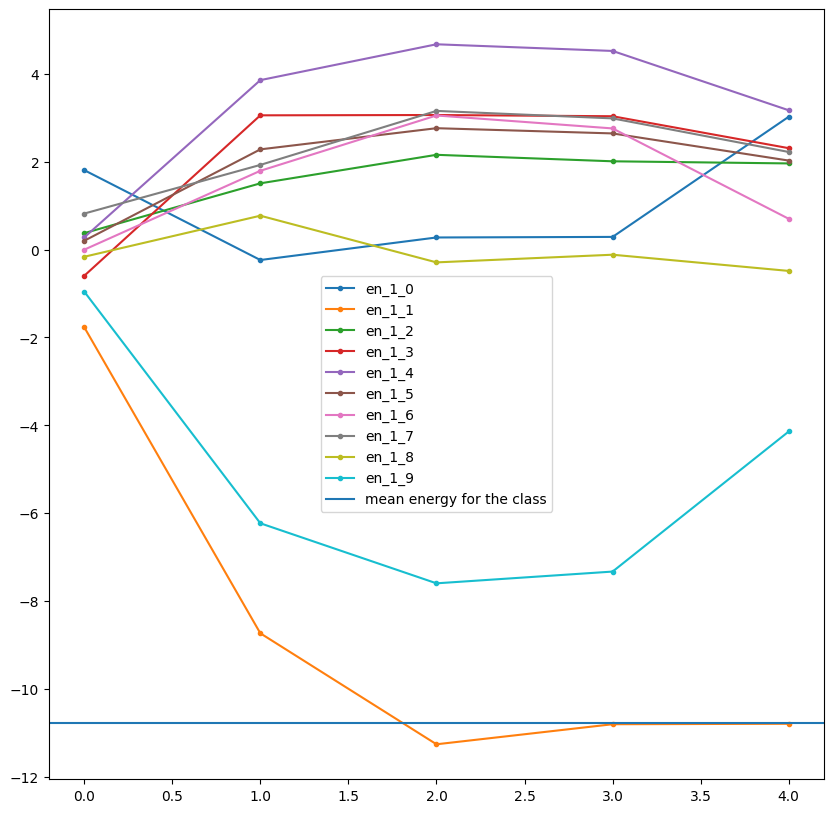

In [33]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT_adaptive[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


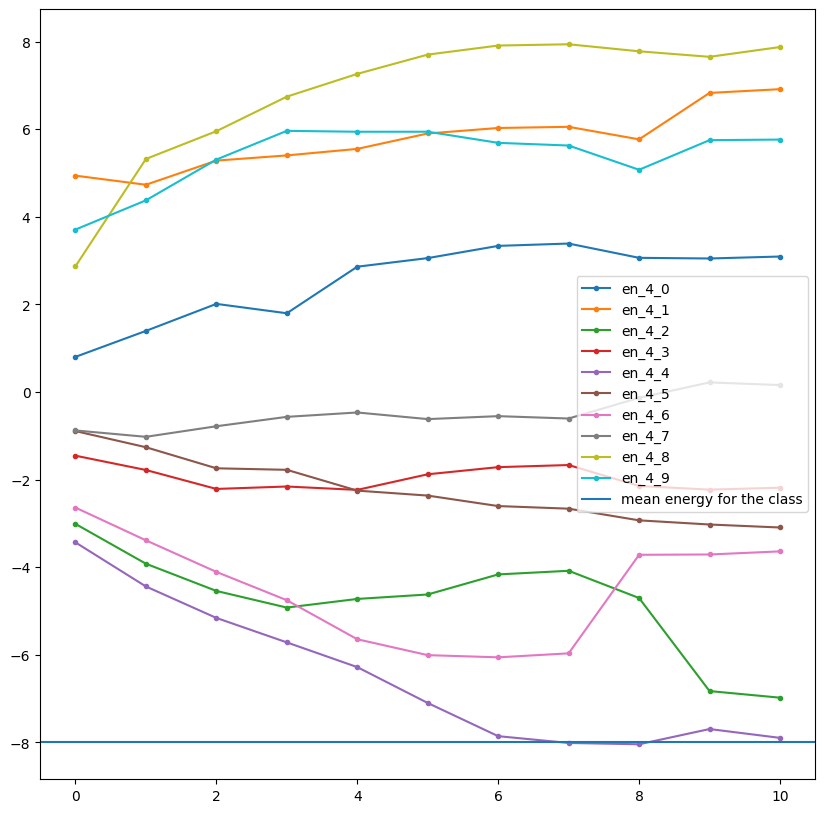

In [34]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 4

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_REFERENCE_ENERGY_DICT_adaptive[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


## the plot is  with  loss = `reference_energy_xy` and NO early stopping 
WITH Metropolis hastings algorithm 


No Momentum


In [35]:
info_REFERENCE_ENERGY_DICT_xy_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


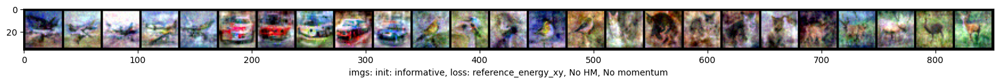

SAT


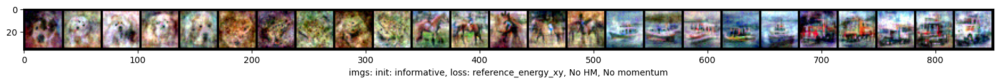

PLOT of THE PCA INIT
SAT


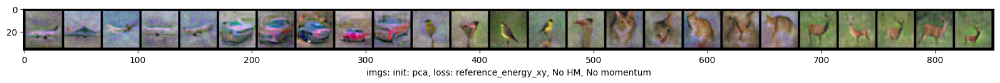

SAT


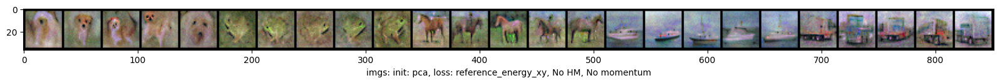

PLOT of  THE REAL IMAGES


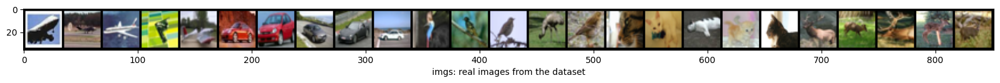

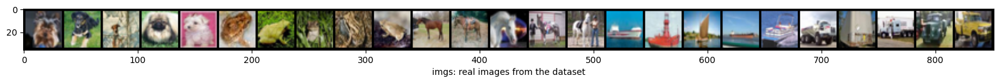

In [36]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_MH[key] = value

info_REFERENCE_ENERGY_DICT_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_MH[key].append(flag_list)
        except:
            pass
        
print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_MH[key] = value


pca_REFERENCE_ENERGY_DICT_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_MH[key].append(flag_list)
        except:
            pass
        

## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

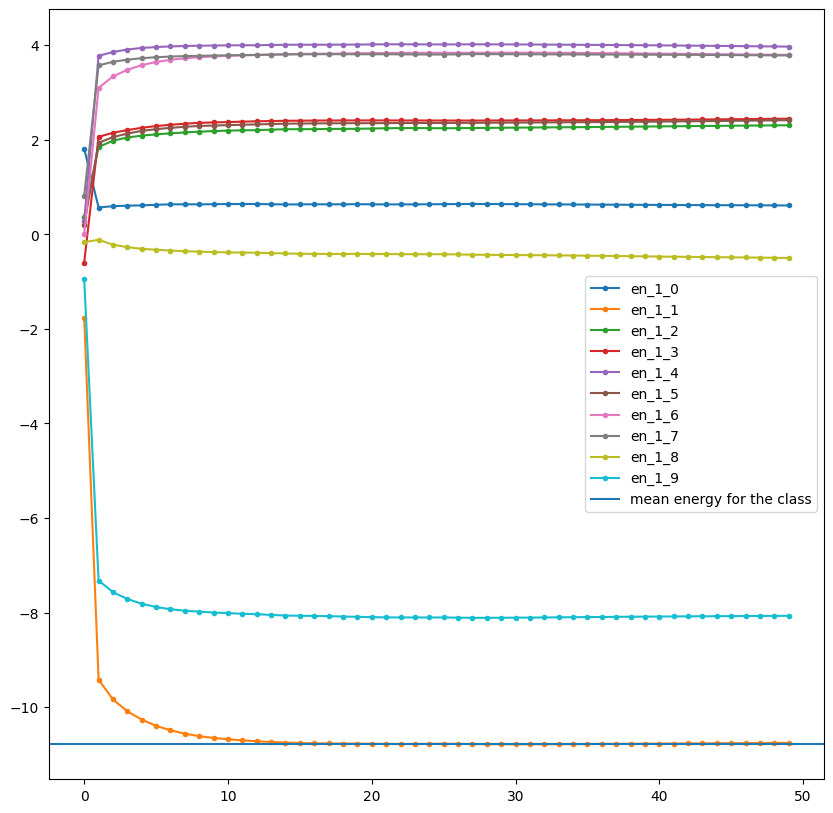

In [37]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


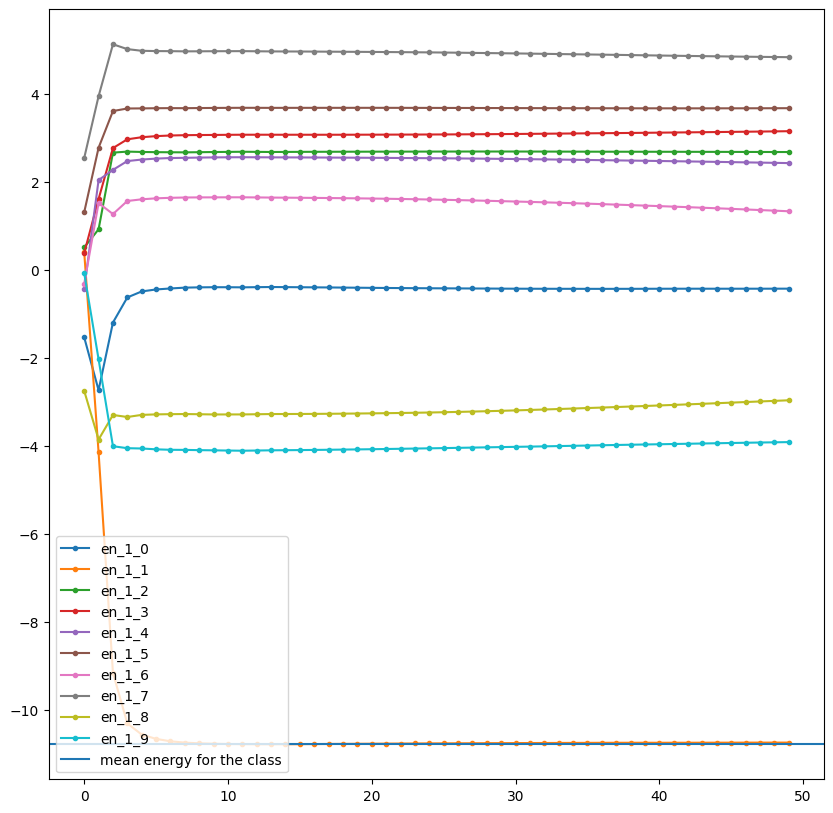

In [38]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_REFERENCE_ENERGY_DICT_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


## the plot is  with  loss = `reference_energy_xy` and WITH early stopping 
WITH Metropolis hastings algorithm 


No Momentum


In [39]:
info_REFERENCE_ENERGY_DICT_xy_adaptive_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_adaptive_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


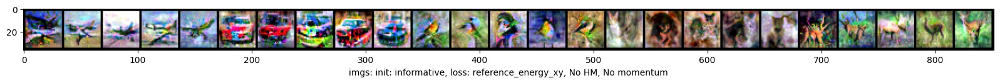

SAT


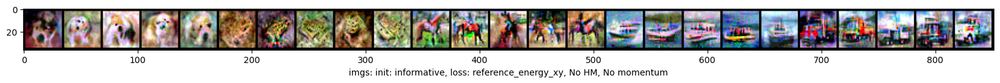

PLOT of THE PCA INIT
SAT


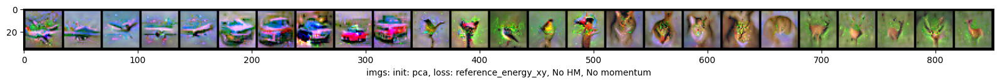

SAT


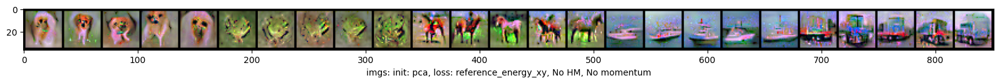

PLOT of  THE REAL IMAGES


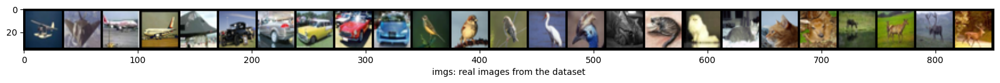

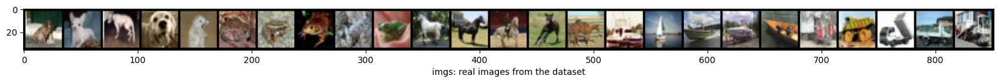

In [40]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            adaptive = 0.001,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_adaptive_MH[key] = value

info_REFERENCE_ENERGY_DICT_adaptive_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_adaptive_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_adaptive_MH[key].append(flag_list)
        except:
            pass
        
print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            adaptive = 0.001,
            HM = True
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_adaptive_MH[key] = value


pca_REFERENCE_ENERGY_DICT_adaptive_MH={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_adaptive_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_adaptive_MH[key].append(flag_list)
        except:
            pass
        

## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

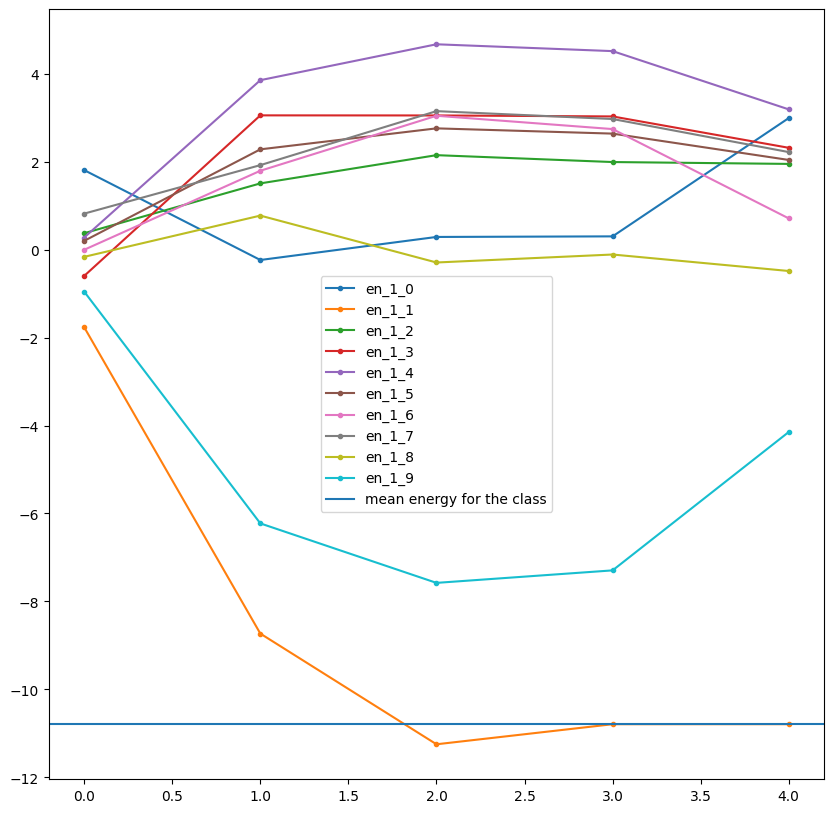

In [41]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT_adaptive_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


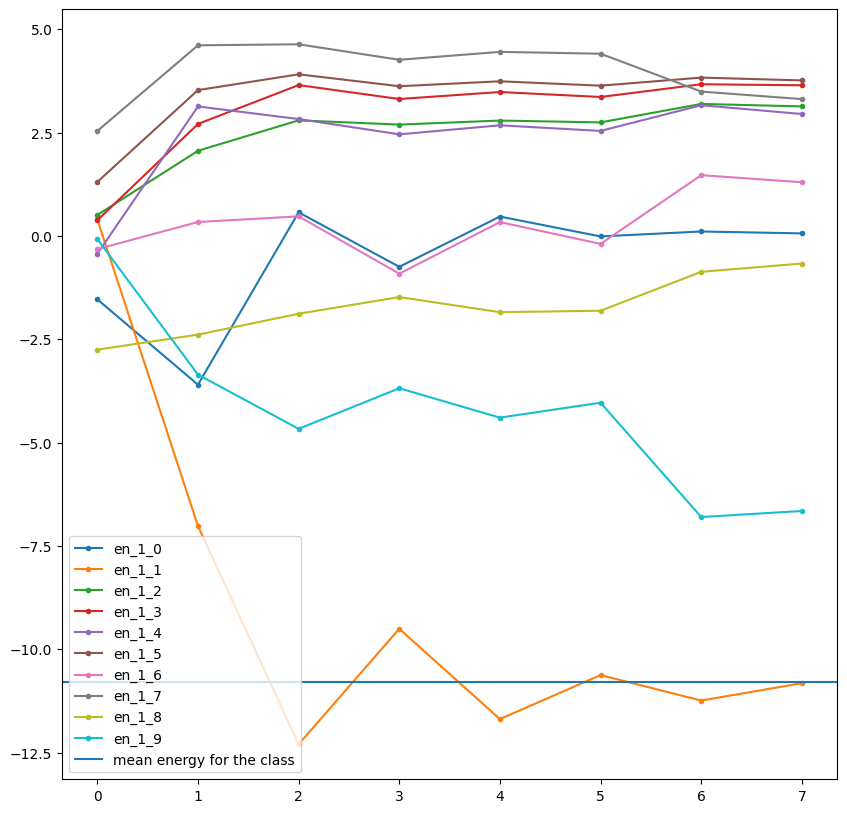

In [42]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_REFERENCE_ENERGY_DICT_adaptive_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


## the plot is  with  loss = `reference_energy_xy` and NO early stopping 
No Metropolis hastings algorithm 


With Momentum


In [43]:
info_REFERENCE_ENERGY_DICT_xy_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


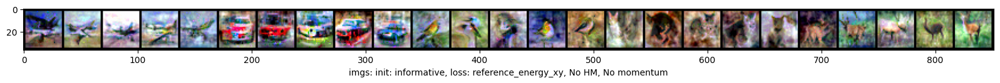

SAT


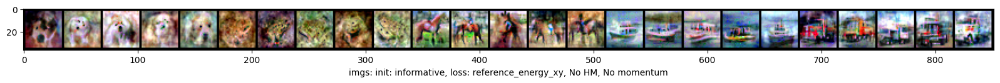

PLOT of THE PCA INIT
SAT


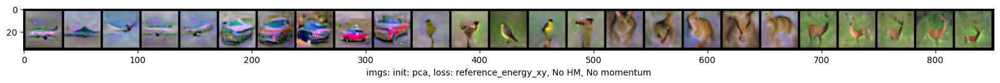

SAT


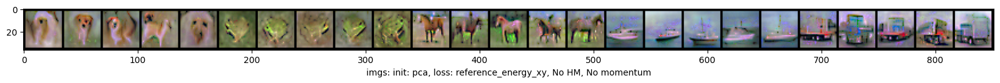

PLOT of  THE REAL IMAGES


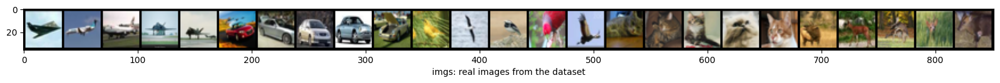

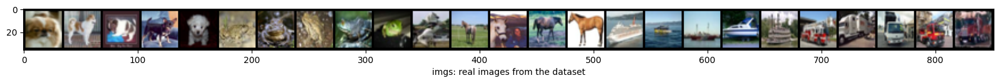

In [44]:
print(
    "PLOT of THE INFORMATIVE INIT"
)
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            noise_variance=0.001,   
            compute_energy_model=True,
            momentum = 0.5
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_momentum[key] = value

info_REFERENCE_ENERGY_DICT_momentum={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_momentum.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_momentum[key].append(flag_list)
        except:
            pass
        
print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum = 0.5
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_momentum[key] = value


pca_REFERENCE_ENERGY_DICT_momentum={
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_momentum.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i+sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_momentum[key].append(flag_list)
        except:
            pass
        

## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

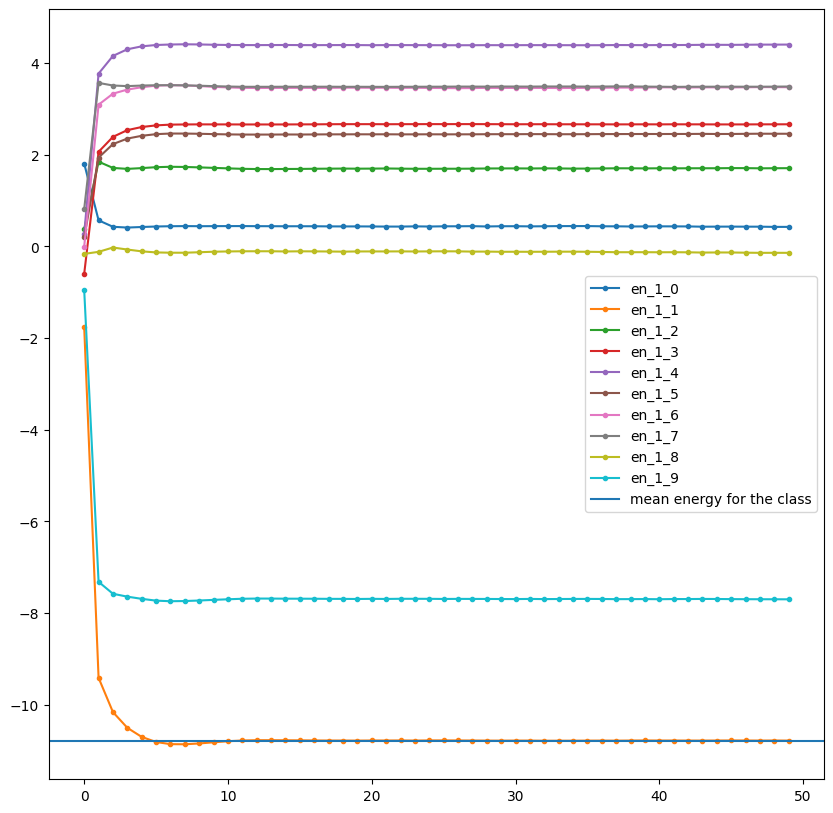

In [45]:

# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT_momentum[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()





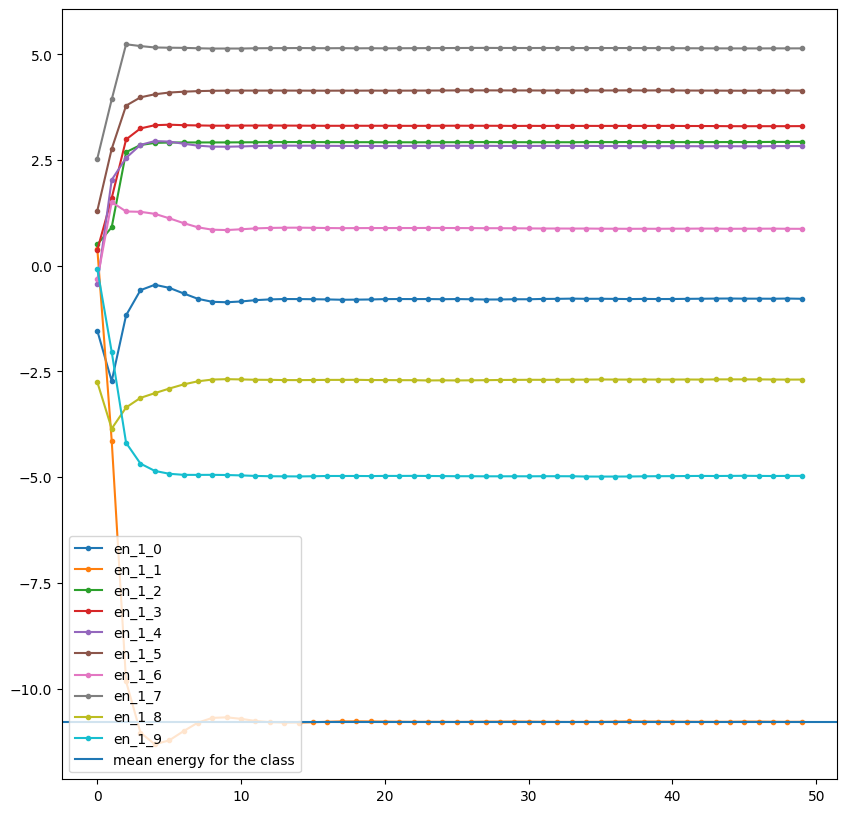

In [46]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_REFERENCE_ENERGY_DICT_momentum[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()

## the plot is  with  loss = `reference_energy_xy` and WITH early stopping 
No Metropolis hastings algorithm 


With Momentum


In [47]:
info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


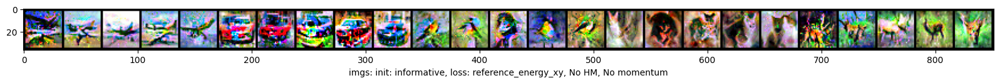

SAT


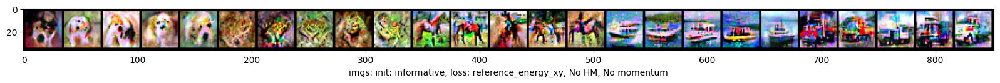

PLOT of THE PCA INIT
SAT


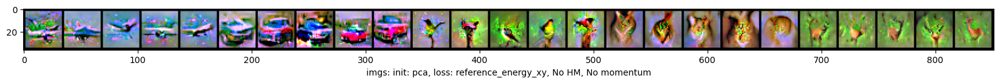

SAT


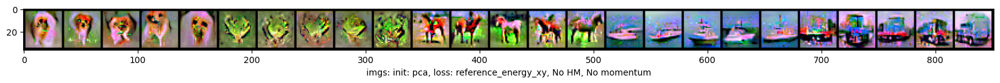

PLOT of  THE REAL IMAGES


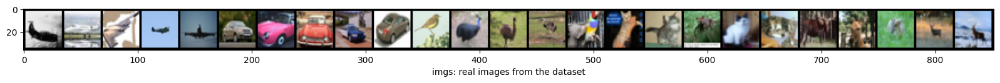

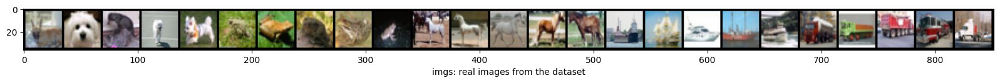

In [48]:
print("PLOT of THE INFORMATIVE INIT")
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            adaptive = 0.001,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum[key] = value

info_REFERENCE_ENERGY_DICT_adaptive_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_adaptive_momentum[key].append(flag_list)
        except:
            pass

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            variance=0.95,
            adaptive = 0.001,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum[key] = value


pca_REFERENCE_ENERGY_DICT_adaptive_momentum = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_adaptive_momentum[key].append(flag_list)
        except:
            pass


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )


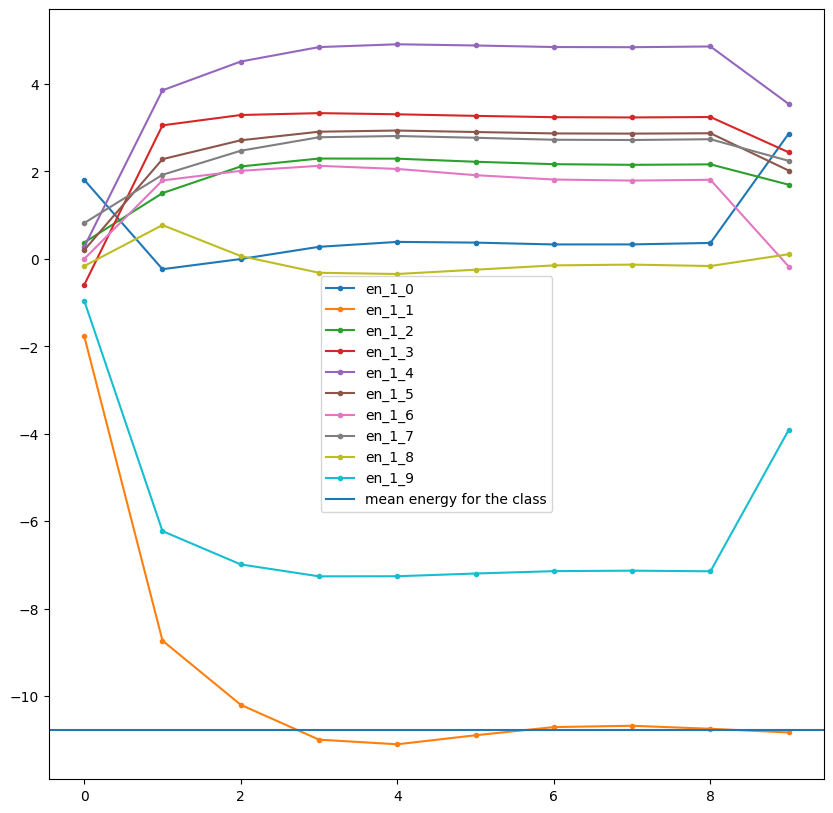

In [49]:
import matplotlib.pyplot as plt

sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes
for c in range(num_classes):
    plt.plot(
        info_REFERENCE_ENERGY_DICT_adaptive_momentum[f"{class_index}_{c}"][sample_index],
        ".-",
        label=f"en_{class_index}_{c}",
    )

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index], linestyle="-", label="mean energy for the class")
plt.legend()
plt.show()



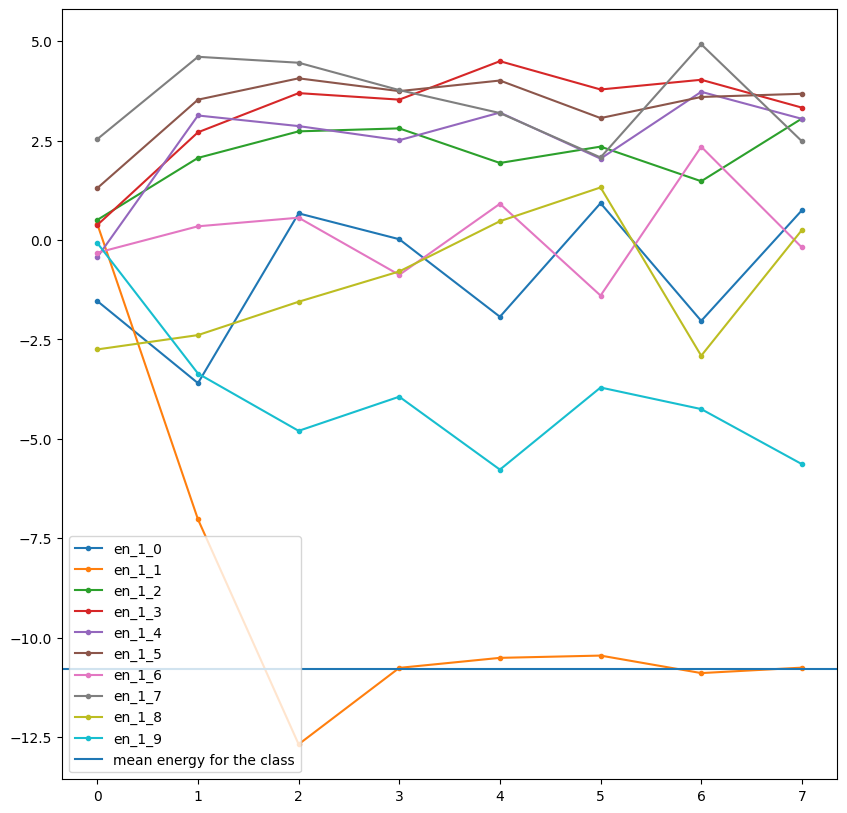

In [50]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt

sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes
for c in range(num_classes):
    plt.plot(
        pca_REFERENCE_ENERGY_DICT_adaptive_momentum[f"{class_index}_{c}"][sample_index],
        ".-",
        label=f"en_{class_index}_{c}",
    )

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index], linestyle="-", label="mean energy for the class")
plt.legend()
plt.show()

## the plot is  with  loss = `reference_energy_xy` and NO early stopping 
With Metropolis hastings algorithm 


With Momentum


In [51]:
info_REFERENCE_ENERGY_DICT_xy_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


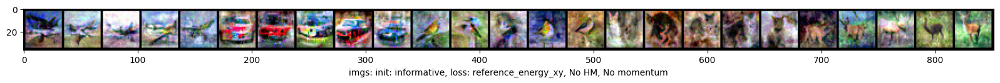

SAT


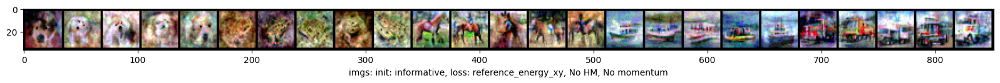

PLOT of THE PCA INIT
SAT


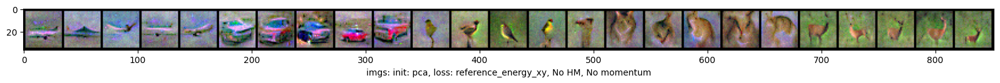

SAT


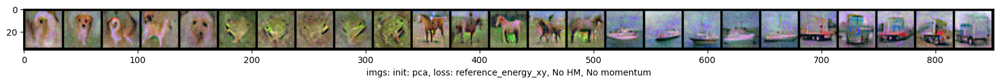

PLOT of  THE REAL IMAGES


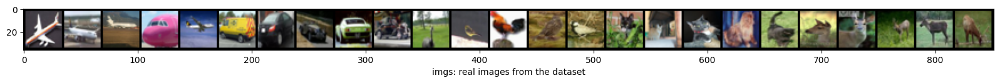

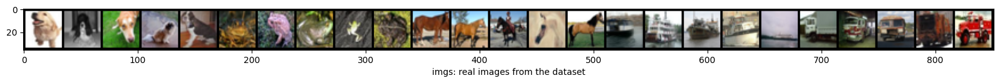

In [52]:
print("PLOT of THE INFORMATIVE INIT")
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM=True,
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_momentum_MH[key] = value

info_REFERENCE_ENERGY_DICT_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_momentum_MH[key].append(flag_list)
        except:
            pass

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM=True,
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_momentum_MH[key] = value


pca_REFERENCE_ENERGY_DICT_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_momentum_MH[key].append(flag_list)
        except:
            pass


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

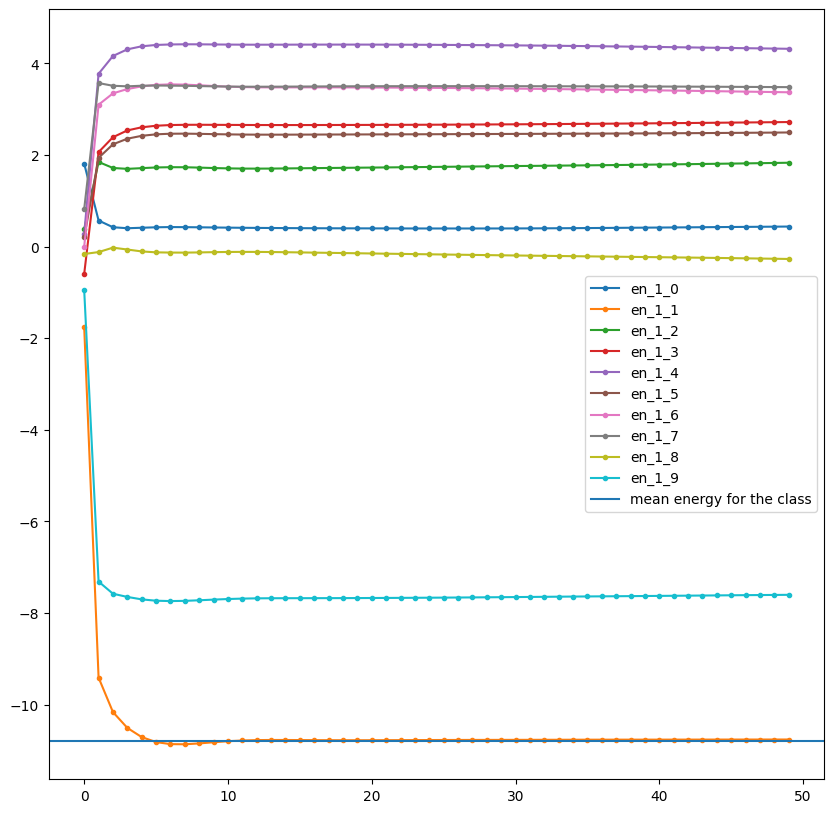

In [53]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(info_REFERENCE_ENERGY_DICT_momentum_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()


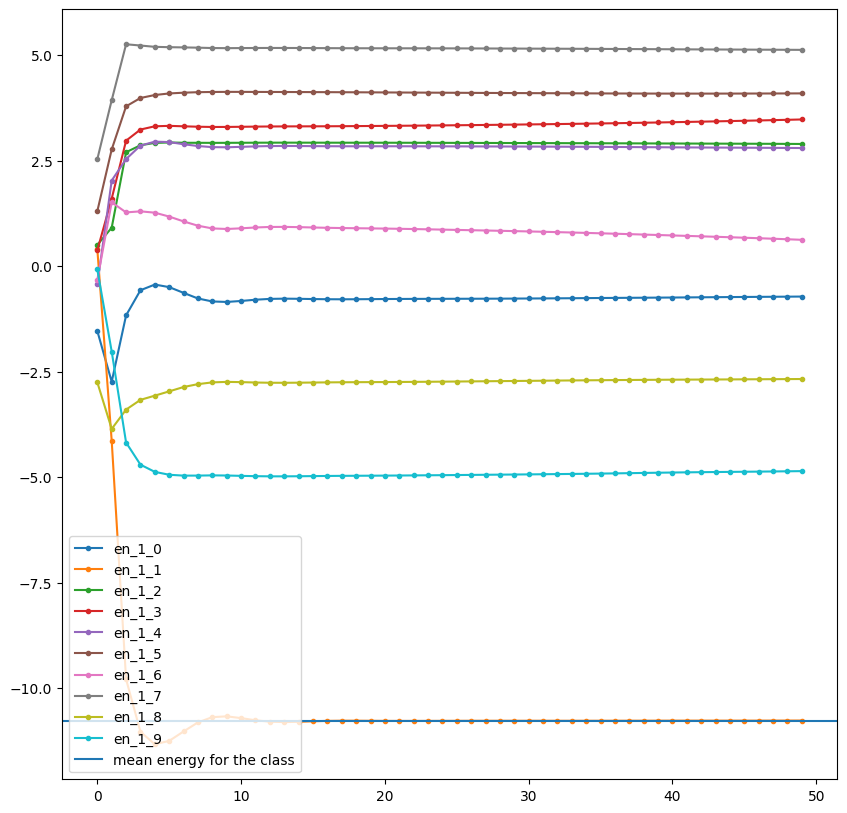

In [54]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt
sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes 
for c in range(num_classes):
    plt.plot(pca_REFERENCE_ENERGY_DICT_momentum_MH[f'{class_index}_{c}'][sample_index] ,  '.-',label=f'en_{class_index}_{c}')

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index],  linestyle='-',label='mean energy for the class')
plt.legend()
plt.show()

## the plot is  with  loss = `reference_energy_xy` and WITH early stopping 
With Metropolis hastings algorithm 


With Momentum


In [55]:
info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
size_plots = 20

PLOT of THE INFORMATIVE INIT
SAT


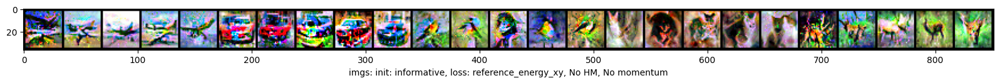

SAT


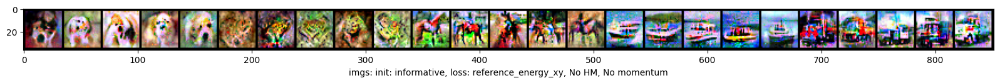

PLOT of THE PCA INIT
SAT


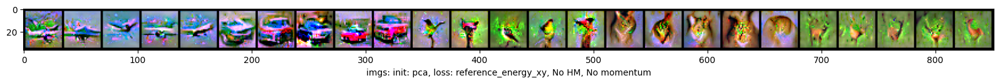

SAT


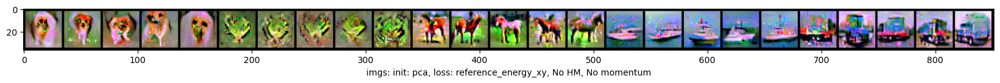

PLOT of  THE REAL IMAGES


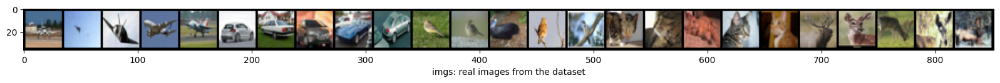

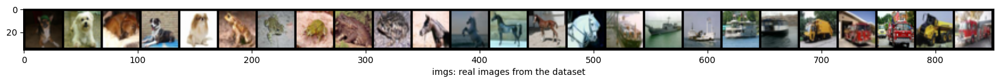

In [56]:
print("PLOT of THE INFORMATIVE INIT")
for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="informative",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM=True,
            adaptive=0.001,
        )
        init.append(x0)
        img.append(imgs)

    torch.cat(init, dim=0)
    img_cat = torch.cat(img, dim=0)
    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: informative, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH[key] = value

info_REFERENCE_ENERGY_DICT_adaptive_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in info_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            info_REFERENCE_ENERGY_DICT_adaptive_momentum_MH[key].append(flag_list)
        except:
            pass

print("PLOT of THE PCA INIT")

for labels in LABEL_TO_PLOT:
    init, img = [], []
    for name, model in MODELS.items():
        print(name)

        fix_seed(seed=seed)
        x0, imgs, energy = utils.new_samples(
            model=model,
            label=labels,
            batch_size=NUM_SAMPLES,
            step_size=0.5,
            n_steps=N_STEPS,
            inizialization="pca",
            N_STEPS_sampling=1,
            loss="reference_energy_xy",
            replay_buffer=REPLAY_BUFFER,
            buffer=BUFFER,
            alpha=1,
            variance=0.95,
            noise_variance=0.001,
            compute_energy_model=True,
            momentum=0.5,
            HM=True,
            adaptive=0.001,
        )
        init.append(x0)
        img.append(imgs)

    init_cat = torch.cat(init, dim=0)

    img_cat = torch.cat(img, dim=0)

    utils_func.plot_imgs_generated(
        img_cat,
        inizialization="init: pca, loss: reference_energy_xy, No HM, No momentum",
        rows=len(MODEL_NAMES_DICT.keys()),
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )
    for key, value in energy.items():
        if len(value) > 0:
            pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH[key] = value


pca_REFERENCE_ENERGY_DICT_adaptive_momentum_MH = {
    f"{i}_{j}": [] for j in range(num_classes) for i in range(num_classes)
}
for key, value in pca_REFERENCE_ENERGY_DICT_xy_adaptive_momentum_MH.items():
    for sample in range(NUM_SAMPLES):
        try:
            flag_list = [value[i + sample] for i in range(0, len(value), NUM_SAMPLES)]
            pca_REFERENCE_ENERGY_DICT_adaptive_momentum_MH[key].append(flag_list)
        except:
            pass


## PLOT THE REAL IMAGES
print("PLOT of  THE REAL IMAGES")

batch = next(iter(TRAIN_DATALOADER))
labels = batch[1]

samp = {i: [] for i in range(10)}
for i, sample in enumerate(batch[0]):
    samp[labels[i].item()].append(sample)


for k in range(len(LABEL_TO_PLOT)):
    imgs = []
    for i in range(0, 5):
        for j in range(NUM_SAMPLES):
            imgs.append(samp[i + k * NUM_SAMPLES][j])
    # i have a list of tensor i want to convert it to a tensor
    imgs = torch.stack(imgs)

    utils_func.plot_imgs_generated(
        imgs,
        inizialization="real images from the dataset",
        rows=1,
        size=(size_plots, size_plots),
        path="./data/imgs.pdf",
        name="imgs: ",
    )

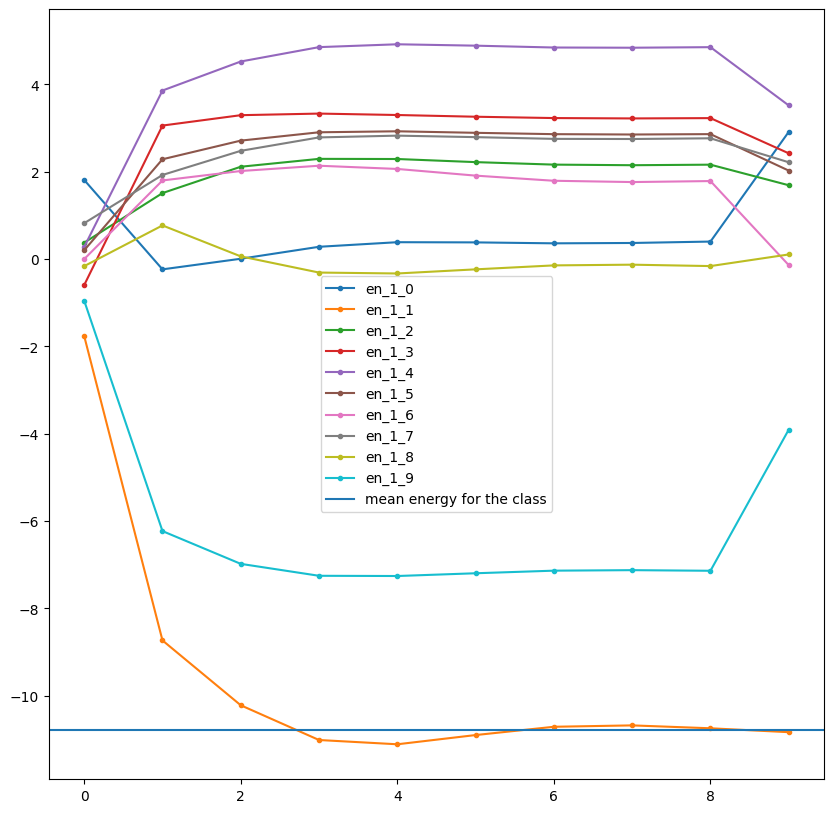

In [57]:
import matplotlib.pyplot as plt

sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes
for c in range(num_classes):
    plt.plot(
        info_REFERENCE_ENERGY_DICT_adaptive_momentum_MH[f"{class_index}_{c}"][
            sample_index
        ],
        ".-",
        label=f"en_{class_index}_{c}",
    )

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index], linestyle="-", label="mean energy for the class")
plt.legend()
plt.show()

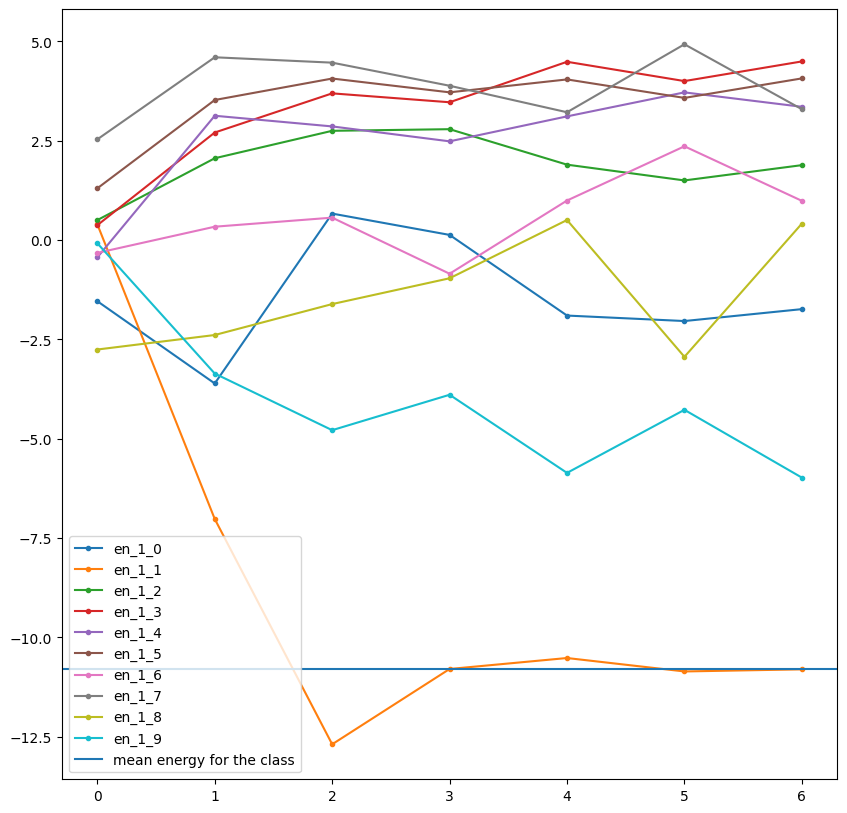

In [58]:
# i want to plot the energy of the the i-th sample of the j-th class
import matplotlib.pyplot as plt

sample_index = 0
class_index = 1

plt.figure(figsize=(10, 10))
# and also all the energies of the samples of the j-th class with the other classes
for c in range(num_classes):
    plt.plot(
        pca_REFERENCE_ENERGY_DICT_adaptive_momentum_MH[f"{class_index}_{c}"][sample_index],
        ".-",
        label=f"en_{class_index}_{c}",
    )

# show the average energy of the samples of each class with an horizontal line
plt.axhline(y=MEAN_EN[class_index], linestyle="-", label="mean energy for the class")
plt.legend()
plt.show()